# Analysis Overview
In this competition, we are working with a time-series dataset containing the energy consumption and production of numerous users. The dataset accounts for variations in size and energy usage patterns among the users. The time-dependent expenditure is believed to be related to factors such as geographical location, local weather, and energy prices, which are included in the dataset.

This notebook consists of the following stages:

- **Data Preprocessing:** We will combine several datasets, both from private and public data provided in the competition.
- **Exploratory Data Analysis (EDA):** Utilizing methods like Fast Fourier Transform (FFT) and Singular Spectrum Analysis (SSA), we will investigate the underlying periodic patterns for an example user.
- **Predictive Modeling:** We will deploy a Voting Regressor ensemble model, incorporating Light Gradient Boosting Method (LGBM) models. The objective here is to generate predictions related to energy consumption and production.

In [1]:
import os

import numpy as np
import pandas as pd
import polars as pl
import random
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.ensemble import VotingRegressor

import lightgbm as lgb
from catboost import CatBoostRegressor

import warnings
# Filter out specific ValueWarnings from statsmodels
warnings.filterwarnings("ignore")

# pandas max columns
pd.set_option('display.max_columns',None)

# Importing Data
Since not all columns are useful, all columns other than specified ones will be discarded.

In [3]:
# root = "/kaggle/input/predict-energy-behavior-of-prosumers"
root = '../data'

## Define important columns
data_cols = ['target', 'county', 'is_business', 'product_type', 'is_consumption', 'datetime', 'row_id']
client_cols = ['product_type', 'county', 'eic_count', 'installed_capacity', 'is_business', 'date']
gas_prices_cols = ['forecast_date', 'lowest_price_per_mwh', 'highest_price_per_mwh']
electricity_prices_cols = ['forecast_date', 'euros_per_mwh']
forecast_weather_cols = ['latitude', 'longitude', 'hours_ahead', 'temperature', 'dewpoint', 'cloudcover_high', 'cloudcover_low', 'cloudcover_mid', 'cloudcover_total', '10_metre_u_wind_component', '10_metre_v_wind_component', 'forecast_datetime', 'direct_solar_radiation', 'surface_solar_radiation_downwards', 'snowfall', 'total_precipitation']
historical_weather_cols = ['datetime', 'temperature', 'dewpoint', 'rain', 'snowfall', 'surface_pressure','cloudcover_total','cloudcover_low','cloudcover_mid','cloudcover_high','windspeed_10m','winddirection_10m','shortwave_radiation','direct_solar_radiation','diffuse_radiation','latitude','longitude']
location_cols = ['longitude', 'latitude', 'county']
target_cols = ['target', 'county', 'is_business', 'product_type', 'is_consumption', 'datetime']

## Importing only specified columns(=important columns)
df_data = pl.read_csv(os.path.join(root, "train.csv"), columns=data_cols, try_parse_dates=True)
df_client = pl.read_csv(os.path.join(root, "client.csv"), columns=client_cols, try_parse_dates=True)
df_gas_prices = pl.read_csv(os.path.join(root, "gas_prices.csv"), columns=gas_prices_cols, try_parse_dates=True)
df_electricity_prices = pl.read_csv(os.path.join(root, "electricity_prices.csv"), columns=electricity_prices_cols, try_parse_dates=True)
df_forecast_weather = pl.read_csv(os.path.join(root, "forecast_weather.csv"), columns=forecast_weather_cols, try_parse_dates=True)
df_historical_weather = pl.read_csv(os.path.join(root, "historical_weather.csv"), columns=historical_weather_cols, try_parse_dates=True)
df_weather_station_to_county_mapping = pl.read_csv(os.path.join(root, "weather_station_to_county_mapping.csv"), columns=location_cols, try_parse_dates=True)
df_target = df_data.select(target_cols)

## Prepare schema for api submission
schema_data = df_data.schema
schema_client = df_client.schema
schema_gas  = df_gas_prices.schema
schema_electricity = df_electricity_prices.schema
schema_forecast = df_forecast_weather.schema
schema_historical = df_historical_weather.schema
schema_target = df_target.schema

# Preprocessing
- **Type Casting and Renaming:** The function starts by casting the latitude and longitude columns to Float32 for efficiency in df_weather_station_to_county_mapping. It also renames columns in df_gas_prices and df_electricity_prices for consistency.<br/>
 효율성을 위해 df_weather_station_to_county_mapping의 위도경도 데이터를 float32 데이터 타입으로 변형, 일관성을 위해 df_gas와 df_electrictity_prices 데이터의 일부 컬럼명을 변경
- **Aggregating Target Data:** It aggregates target data in df_target by grouping on certain columns and summing up the targets, creating a summarized view.<br/>
 기준에 따라 row를 합쳐서 summarized view를 만든다.
- **Weather Data Processing:** The function processes both forecast and historical weather data (df_forecast_weather and df_historical_weather) by renaming columns, filtering, and joining with the weather station to county mapping data.<br/>
 weather 데이터들을 county와 매핑하여 county의 날씨 데이터를 만드는 듯. weather station별로 날씨 데이터를 summarize?
- **Creating Average Weather Characteristics:** It calculates average weather characteristics for both types of weather data, providing a summarized view of weather conditions.<br/>
 날씨 데이터에 대한 요약
- **Feature Engineering and Joining Dataframes:** The main dataframe, df_data, is enriched with additional features through a series of join operations with other dataframes. These operations include joining lagged gas prices, client data, electricity prices, weather data, and aggregated target data.<br/>
  df_train과 다른 데이터셋들을 merge함. 
- **Extracting Time-Related Features:** The function extracts and calculates various time-related features like the ordinal day, hour, and cyclical features using sine and cosine transformations.
 <br/> 여러 시간 관련 피처들을 추출(월별, 주별, 분기별, 반기별,..., 사인/코사인 변환)
- **Final Dataframe Preparation:** Finally, unnecessary columns are dropped, and the processed dataframe is returned, ready for use in predictive modeling.
 <br/> DF 객체로 변환

In [4]:
def generate_features(df_data, df_client, df_gas_prices, df_electricity_prices, df_forecast_weather, df_historical_weather, df_weather_station_to_county_mapping, df_target):
    ### 시간 데이터 변환하는 코드 시작 (pandas의 to_datetime()같은 거 )###    
    df_data = (
        df_data.with_columns(pl.col("datetime").cast(pl.Date).alias("date"),)
    )
    
    df_gas_prices = (
        df_gas_prices.rename({"forecast_date": "date"})
    )
    
    df_electricity_prices = (
        df_electricity_prices.rename({"forecast_date": "datetime"})
    )
    
    ### 시간 데이터 변환하는 코드 끝 ###
    
    ### 위경도를 float32로 변환 ###
    df_weather_station_to_county_mapping = (
        df_weather_station_to_county_mapping.with_columns(pl.col("latitude").cast(pl.datatypes.Float32),pl.col("longitude").cast(pl.datatypes.Float32))
    )
    ###
    
    
    ### product_type을 별로 중요하게 생각하지 않는 듯 -> product_type segment를 다 더해버림 ###
    # sum of all product_type targets related to ["datetime", "county", "is_business", "is_consumption"]
    df_target_all_type_sum = (
        df_target.group_by(["datetime", "county", "is_business", "is_consumption"]).sum().drop("product_type")
    )
    ###
    
    '''
    forecast_weather
    - origin datetime이 05-27 00:00:00일 때, 05-27의 날씨를 예측한 데이터는 필요 없음 -> hours_ahead>=24로 필터링
    - 시간대를 us 시간대로 맞춤.
    - weather_station_to_county_mapping와 join하여 weather_station별로 forecast_weather를 생성.
    '''
    df_forecast_weather = (
        df_forecast_weather.rename({"forecast_datetime": "datetime"}).filter(pl.col("hours_ahead") >= 24) # we don't need forecast for today
        .with_columns(pl.col("latitude").cast(pl.datatypes.Float32),pl.col("longitude").cast(pl.datatypes.Float32),
            # datetime for forecast in a different timezone
            pl.col('datetime').dt.replace_time_zone(None).cast(pl.Datetime("us")),
        )
        .join(df_weather_station_to_county_mapping, how="left", on=["longitude", "latitude"]).drop("longitude", "latitude")
    )
    
    '''
    - weather_station_to_county_mapping와 join하여 weather_station별로 historical_weather를 생성.
    '''
    df_historical_weather = (
        df_historical_weather
        .with_columns(pl.col("latitude").cast(pl.datatypes.Float32),pl.col("longitude").cast(pl.datatypes.Float32),
        )
        .join(df_weather_station_to_county_mapping, how="left", on=["longitude", "latitude"]).drop("longitude", "latitude")
    )

    '''
    weather_stations 별로 datetime별 평균값을 냄.
    '''
    # creating average forecast characteristics for all weather stations
    df_forecast_weather_date = (
        df_forecast_weather.group_by("datetime").mean().drop("county")
    )
    
    '''
    county가 있는 weather station만 남겨둠 (weather station 시각화했던 kaggle 사이트에서 회색 동그라미에 해당했던 데이터를 삭제)
    '''
    # creating average forecast characteristics for weather stations related to county
    df_forecast_weather_local = (
        df_forecast_weather.filter(pl.col("county").is_not_null()).group_by("county", "datetime").mean()
    )

    '''
    historical_weather도 동일한 과정 거침
    '''
    # creating average historical characteristics for all weather stations
    df_historical_weather_date = (
        df_historical_weather.group_by("datetime").mean().drop("county")
    )
    
    # creating average historical characteristics for weather stations related to county
    df_historical_weather_local = (
        df_historical_weather.filter(pl.col("county").is_not_null()).group_by("county", "datetime").mean()
    )
    
    
    '''
    데이터 merge
    pl.duration(days=n)을 하면 기존 date에 n일을 더해주는 것.
    '''
    df_data = (
        df_data
        # pl.duration(days=1) shifts datetime to join lag features (usually we join last available values)
        .join(df_gas_prices.with_columns((pl.col("date") + pl.duration(days=1)).cast(pl.Date)), on="date", how="left")
        .join(df_client.with_columns((pl.col("date") + pl.duration(days=2)).cast(pl.Date)), on=["county", "is_business", "product_type", "date"], how="left")
        .join(df_electricity_prices.with_columns(pl.col("datetime") + pl.duration(days=1)), on="datetime", how="left")
        
        # lag forecast_weather features (24 hours * days)
        .join(df_forecast_weather_date, on="datetime", how="left", suffix="_fd")
        .join(df_forecast_weather_local, on=["county", "datetime"], how="left", suffix="_fl")
        .join(df_forecast_weather_date.with_columns(pl.col("datetime") + pl.duration(days=7)), on="datetime", how="left", suffix="_fd_7d")
        .join(df_forecast_weather_local.with_columns(pl.col("datetime") + pl.duration(days=7)), on=["county", "datetime"], how="left", suffix="_fl_7d")

        # lag historical_weather features (24 hours * days)
        .join(df_historical_weather_date.with_columns(pl.col("datetime") + pl.duration(days=2)), on="datetime", how="left", suffix="_hd_2d")
        .join(df_historical_weather_local.with_columns(pl.col("datetime") + pl.duration(days=2)), on=["county", "datetime"], how="left", suffix="_hl_2d")
        .join(df_historical_weather_date.with_columns(pl.col("datetime") + pl.duration(days=7)), on="datetime", how="left", suffix="_hd_7d")
        .join(df_historical_weather_local.with_columns(pl.col("datetime") + pl.duration(days=7)), on=["county", "datetime"], how="left", suffix="_hl_7d")
        
        # lag target features (24 hours * days)
        .join(df_target.with_columns(pl.col("datetime") + pl.duration(days=2)).rename({"target": "target_1"}), on=["county", "is_business", "product_type", "is_consumption", "datetime"], how="left")
        .join(df_target.with_columns(pl.col("datetime") + pl.duration(days=3)).rename({"target": "target_2"}), on=["county", "is_business", "product_type", "is_consumption", "datetime"], how="left")
        .join(df_target.with_columns(pl.col("datetime") + pl.duration(days=4)).rename({"target": "target_3"}), on=["county", "is_business", "product_type", "is_consumption", "datetime"], how="left")
        .join(df_target.with_columns(pl.col("datetime") + pl.duration(days=5)).rename({"target": "target_4"}), on=["county", "is_business", "product_type", "is_consumption", "datetime"], how="left")
        .join(df_target.with_columns(pl.col("datetime") + pl.duration(days=6)).rename({"target": "target_5"}), on=["county", "is_business", "product_type", "is_consumption", "datetime"], how="left")
        .join(df_target.with_columns(pl.col("datetime") + pl.duration(days=7)).rename({"target": "target_6"}), on=["county", "is_business", "product_type", "is_consumption", "datetime"], how="left")
        .join(df_target.with_columns(pl.col("datetime") + pl.duration(days=14)).rename({"target": "target_7"}), on=["county", "is_business", "product_type", "is_consumption", "datetime"], how="left")
        
        .join(df_target_all_type_sum.with_columns(pl.col("datetime") + pl.duration(days=2)).rename({"target": "target_1"}), on=["county", "is_business", "is_consumption", "datetime"], suffix="_all_type_sum", how="left")
        .join(df_target_all_type_sum.with_columns(pl.col("datetime") + pl.duration(days=3)).rename({"target": "target_2"}), on=["county", "is_business", "is_consumption", "datetime"], suffix="_all_type_sum", how="left")
        .join(df_target_all_type_sum.with_columns(pl.col("datetime") + pl.duration(days=7)).rename({"target": "target_6"}), on=["county", "is_business", "is_consumption", "datetime"], suffix="_all_type_sum", how="left")
        .join(df_target_all_type_sum.with_columns(pl.col("datetime") + pl.duration(days=14)).rename({"target": "target_7"}), on=["county", "is_business", "is_consumption", "datetime"], suffix="_all_type_sum", how="left")
        
        
        .with_columns(
            pl.col("datetime").dt.ordinal_day().alias("dayofyear"),
            pl.col("datetime").dt.hour().alias("hour"),
            pl.col("datetime").dt.day().alias("day"),
            pl.col("datetime").dt.weekday().alias("weekday"),
            pl.col("datetime").dt.month().alias("month"),
            pl.col("datetime").dt.year().alias("year"),
        )
        .with_columns(
            pl.concat_str("county", "is_business", "product_type", "is_consumption", separator="_").alias("segment"),
        )
        # cyclical features encoding https://towardsdatascience.com/cyclical-features-encoding-its-about-time-ce23581845ca
        .with_columns(
            (np.pi * pl.col("dayofyear") / 183).sin().alias("sin(dayofyear)"),
            (np.pi * pl.col("dayofyear") / 183).cos().alias("cos(dayofyear)"),
            (np.pi * pl.col("hour") / 12).sin().alias("sin(hour)"),
            (np.pi * pl.col("hour") / 12).cos().alias("cos(hour)"),
        )
        .with_columns(
            pl.col(pl.Float64).cast(pl.Float32),
        )
        
        .drop("datetime", "hour", "dayofyear")
    )
    
    return df_data

In [5]:
## Function defined for merging dataframes with the row_id as unique identifier
def to_pandas(X, y=None):
    cat_cols = ["county", "is_business", "product_type", "is_consumption", "segment"]
    
    if y is not None:
        df = pd.concat([X.to_pandas(), y.to_pandas()], axis=1)
    else:
        df = X.to_pandas()    
    
    df = df.set_index("row_id")
    df[cat_cols] = df[cat_cols].astype("category")
    
    df["target_mean"] = df[[f"target_{i}" for i in range(1, 7)]].mean(1)
    df["target_std"] = df[[f"target_{i}" for i in range(1, 7)]].std(1)
    df["target_ratio"] = df["target_6"] / (df["target_7"] + 1e-3)
    
    return df

## Applying Preprocessing

1. **Splitting Data into Features and Target**
   - `df_data` is updated to exclude the 'target' column.
   - `y` is created to contain only the 'target' column from `df_data`.

2. **Generating Additional Features**
   - The `generate_features` function is used to enrich `df_data` with new features created from related datasets like client, gas prices, electricity prices, forecast and historical weather data, and weather station mappings.

3. **Transforming Data for Pandas DataFrame**
   - The `to_pandas` function is applied to transform the enriched data into a pandas DataFrame, integrating the target values and creating additional engineered features such as 'target_mean', 'target_std', and 'target_ratio'.

4. **Cleaning Data**
   - Rows with null values in the 'target' column are removed to ensure data quality.
   - The dataset is filtered to include only records from the year 2022 and beyond.

The processed dataset, `df_train_features`, is now optimized and ready for use in machine learning tasks, free from null target values and focused on recent data.


In [6]:
df_data_, y = df_data.drop("target"), df_data.select("target")

df_train_features = generate_features(df_data_, df_client, df_gas_prices, 
                                      df_electricity_prices, df_forecast_weather,
                                      df_historical_weather, df_weather_station_to_county_mapping,
                                      df_target)

df_train_features = to_pandas(df_train_features, y)
# a little proportion of target values are null
df_train_features = df_train_features[df_train_features['target'].notnull()]

# filter old data
df_train_features = df_train_features[df_train_features.year >= 2022]
# 이 코드 생략하니까 2021년도 데이터는 NaN 많이 나옴. pl.duration 때문.

df_train_features.head()

,county,is_business,product_type,is_consumption,date,lowest_price_per_mwh,highest_price_per_mwh,eic_count,installed_capacity,euros_per_mwh,hours_ahead,temperature,dewpoint,cloudcover_high,cloudcover_low,cloudcover_mid,cloudcover_total,10_metre_u_wind_component,10_metre_v_wind_component,direct_solar_radiation,surface_solar_radiation_downwards,snowfall,total_precipitation,hours_ahead_fl,temperature_fl,dewpoint_fl,cloudcover_high_fl,cloudcover_low_fl,cloudcover_mid_fl,cloudcover_total_fl,10_metre_u_wind_component_fl,10_metre_v_wind_component_fl,direct_solar_radiation_fl,surface_solar_radiation_downwards_fl,snowfall_fl,total_precipitation_fl,hours_ahead_fd_7d,temperature_fd_7d,dewpoint_fd_7d,cloudcover_high_fd_7d,cloudcover_low_fd_7d,cloudcover_mid_fd_7d,cloudcover_total_fd_7d,10_metre_u_wind_component_fd_7d,10_metre_v_wind_component_fd_7d,direct_solar_radiation_fd_7d,surface_solar_radiation_downwards_fd_7d,snowfall_fd_7d,total_precipitation_fd_7d,hours_ahead_fl_7d,temperature_fl_7d,dewpoint_fl_7d,cloudcover_high_fl_7d,cloudcover_low_fl_7d,cloudcover_mid_fl_7d,cloudcover_total_fl_7d,10_metre_u_wind_component_fl_7d,10_metre_v_wind_component_fl_7d,direct_solar_radiation_fl_7d,surface_solar_radiation_downwards_fl_7d,snowfall_fl_7d,total_precipitation_fl_7d,temperature_hd_2d,dewpoint_hd_2d,rain,snowfall_hd_2d,surface_pressure,cloudcover_total_hd_2d,cloudcover_low_hd_2d,cloudcover_mid_hd_2d,cloudcover_high_hd_2d,windspeed_10m,winddirection_10m,shortwave_radiation,direct_solar_radiation_hd_2d,diffuse_radiation,temperature_hl_2d,dewpoint_hl_2d,rain_hl_2d,snowfall_hl_2d,surface_pressure_hl_2d,cloudcover_total_hl_2d,cloudcover_low_hl_2d,cloudcover_mid_hl_2d,cloudcover_high_hl_2d,windspeed_10m_hl_2d,winddirection_10m_hl_2d,shortwave_radiation_hl_2d,direct_solar_radiation_hl_2d,diffuse_radiation_hl_2d,temperature_hd_7d,dewpoint_hd_7d,rain_hd_7d,snowfall_hd_7d,surface_pressure_hd_7d,cloudcover_total_hd_7d,cloudcover_low_hd_7d,cloudcover_mid_hd_7d,cloudcover_high_hd_7d,windspeed_10m_hd_7d,winddirection_10m_hd_7d,shortwave_radiation_hd_7d,direct_solar_radiation_hd_7d,diffuse_radiation_hd_7d,temperature_hl_7d,dewpoint_hl_7d,rain_hl_7d,snowfall_hl_7d,surface_pressure_hl_7d,cloudcover_total_hl_7d,cloudcover_low_hl_7d,cloudcover_mid_hl_7d,cloudcover_high_hl_7d,windspeed_10m_hl_7d,winddirection_10m_hl_7d,shortwave_radiation_hl_7d,direct_solar_radiation_hl_7d,diffuse_radiation_hl_7d,target_1,target_2,target_3,target_4,target_5,target_6,target_7,target_1_all_type_sum,target_2_all_type_sum,target_6_all_type_sum,target_7_all_type_sum,day,weekday,month,year,segment,sin(dayofyear),cos(dayofyear),sin(hour),cos(hour),target,target_mean,target_std,target_ratio
row_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
366048,0,0,1,0,2022-01-01,80.0,94.0,148.0,1345.689941,65.760002,47.0,-0.327937,-0.847192,0.267253,0.935247,0.558447,0.997871,0.041798,0.297888,0.0,0.0,0.000022,0.000075,47.0,-4.371883,-4.82631,0.498611,0.999906,0.948502,0.999999,-0.405754,0.660604,0.0,0.0,0.000001,8.772283e-07,47.0,-7.265906,-10.687536,0.004766,0.43738,0.461244,0.700047,3.473562,-3.582645,0.0,0.0,0.000062,0.000062,47.0,-7.529883,-10.003327,0.0,0.590281,0.618098,0.845662,2.40677,-3.49475,0.0,0.0,0.000054,0.000054,-5.085714,-7.095536,0.003571,0.109375,1006.891052,99.70536,94.321426,97.33036,85.60714,4.588789,178.910721,4.6875,1.348214,3.339286,-6.283333,-8.066667,0.0,0.198333,1005.150024,100.0,97.166664,100.0,97.666664,4.407407,168.666672,0.0,0.0,0.0,-8.976786,-11.715178,0.0,0.016875,985.258911,71.20536,55.07143,35.705357,2.232143,5.225695,320.589294,7.321429,4.178571,3.142857,-11.15,-13.433333,0.0,0.035,983.799988,71.666664,79.666664,0.166667,0.0,4.884259,343.833344,0.0,0.0,0.0,0.004000,0.002000,0.00000,0.239000,1.426000,0.007000,0.000000,0.614000,0.399000,0.605000,0.68700,1,6,1,2022,0_0_1_0,0.017166,0.999853,0.0,1.0,0.000,0.279667,0.569453,7.000000
366049,0,0,1,1,2022-01-01,80.0,94.0,148.0

# EDA
For a segment, or a energy consumption/production entity, its energy consumption is shown below as a time series data.

In [9]:
df_train_features['segment'].unique()

['0_0_1_0', '0_0_1_1', '0_0_2_0', '0_0_2_1', '0_0_3_0', ..., '11_1_0_1', '10_1_2_0', '10_1_2_1', '14_1_2_0', '14_1_2_1']
Length: 138
Categories (138, object): ['0_0_1_0', '0_0_1_1', '0_0_2_0', '0_0_2_1', ..., '9_1_1_0', '9_1_1_1', '9_1_3_0', '9_1_3_1']

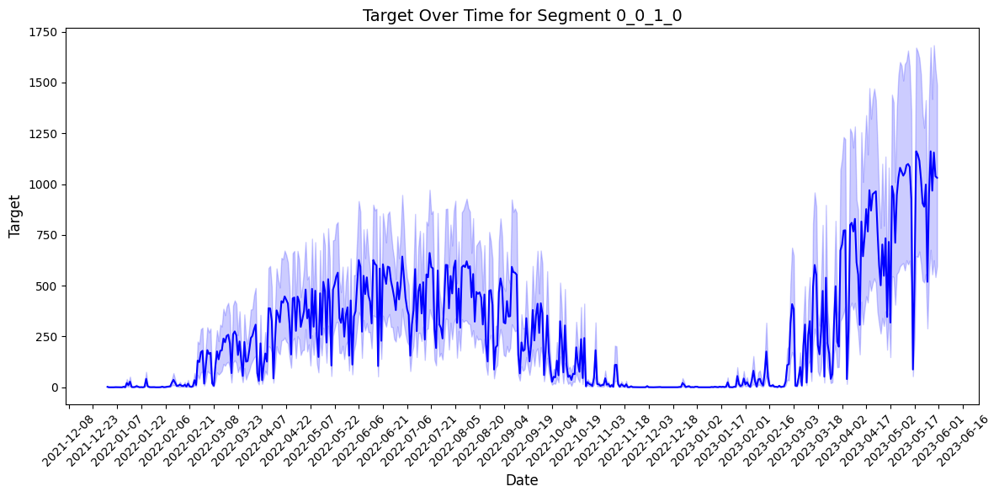

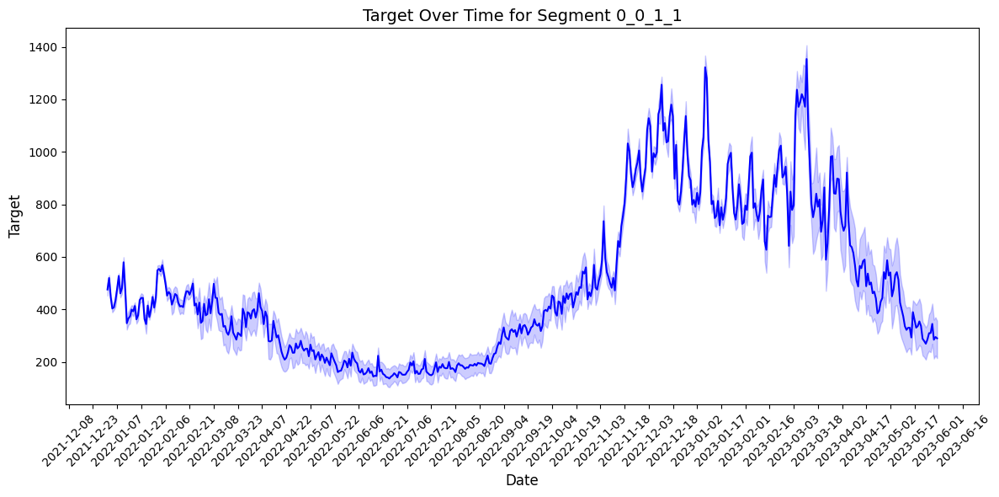

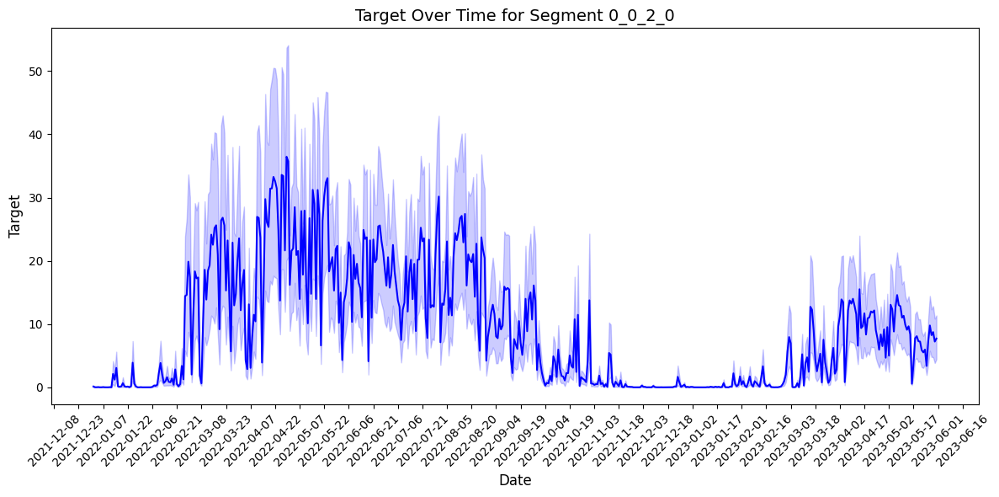

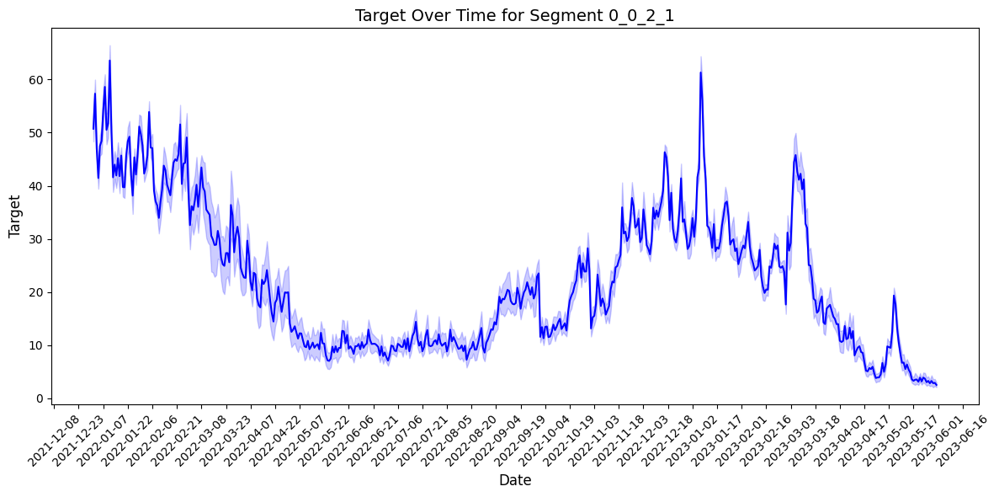

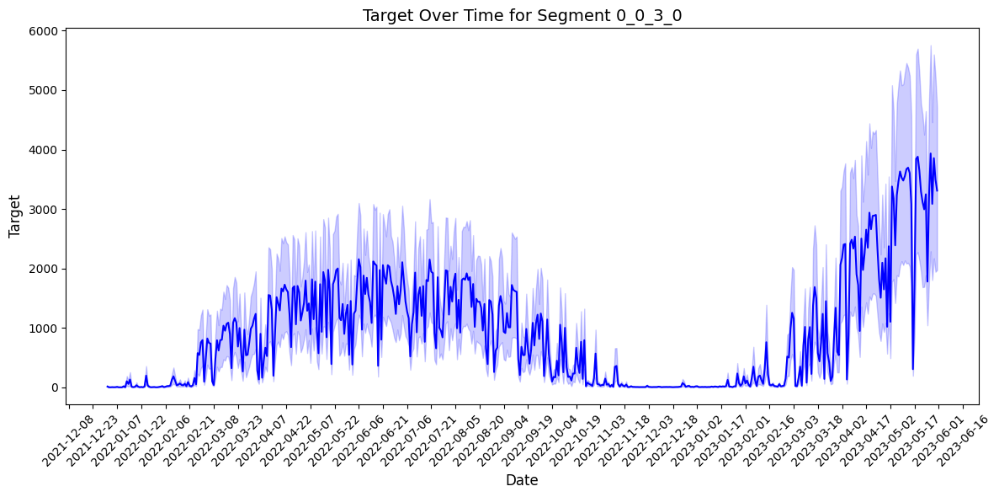

...

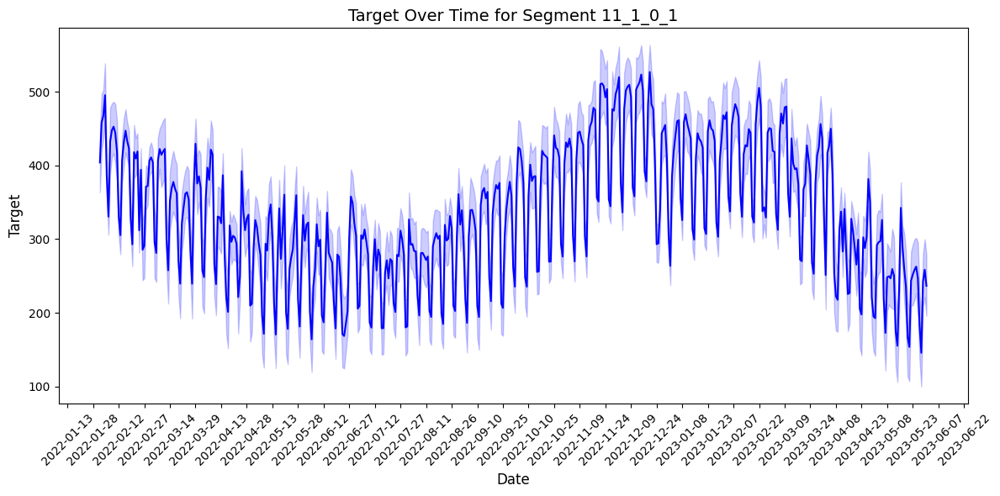

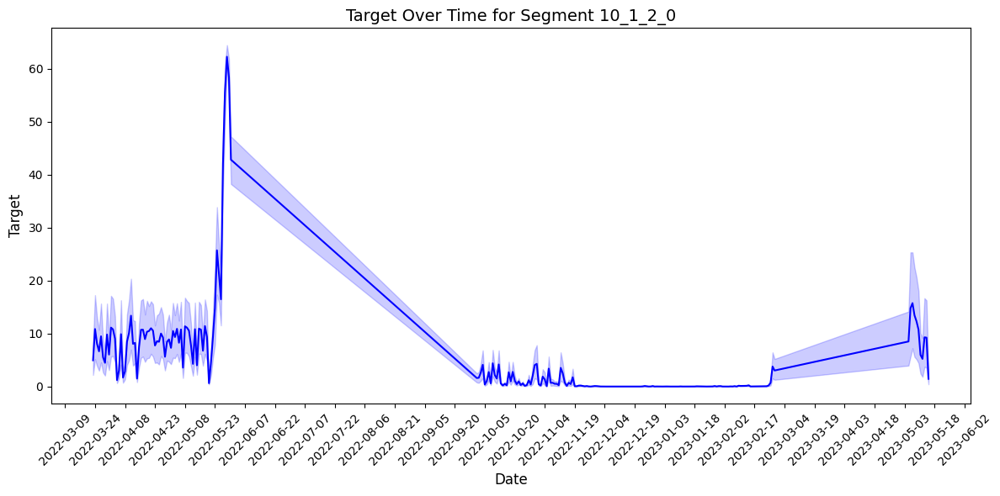

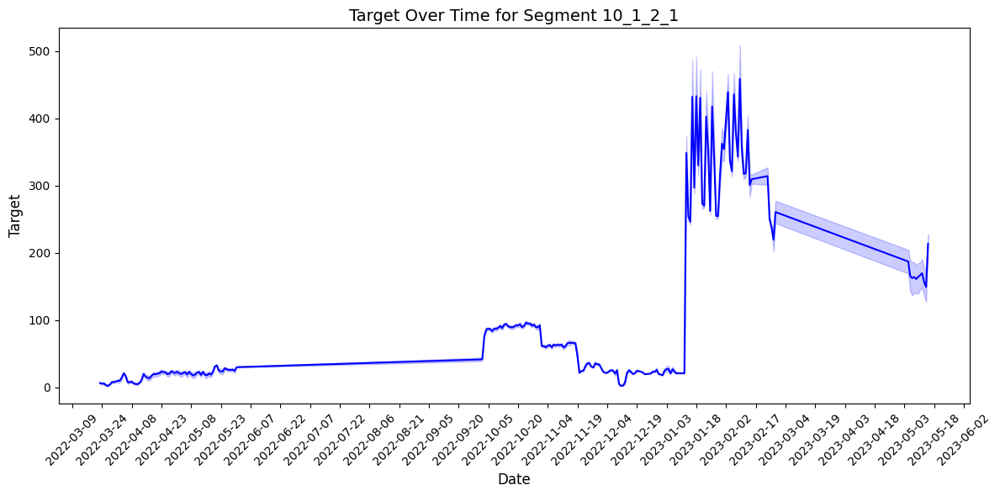

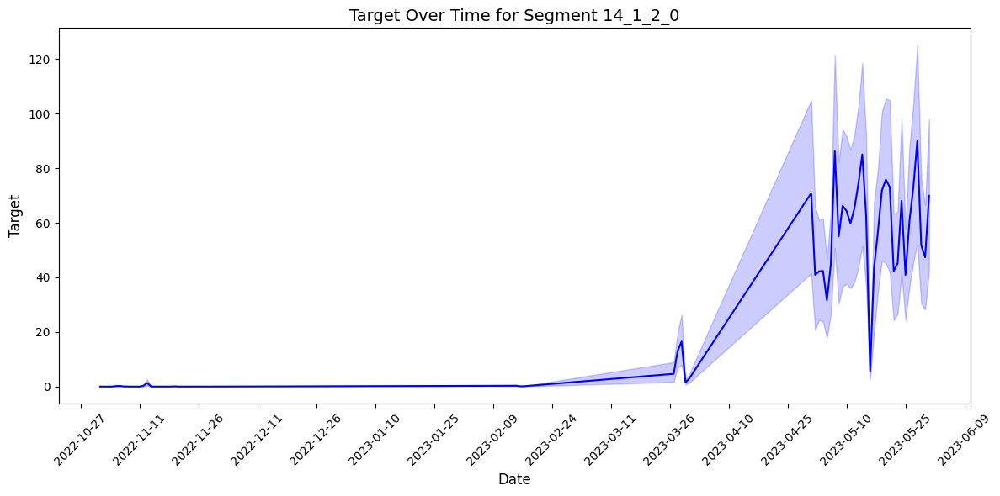

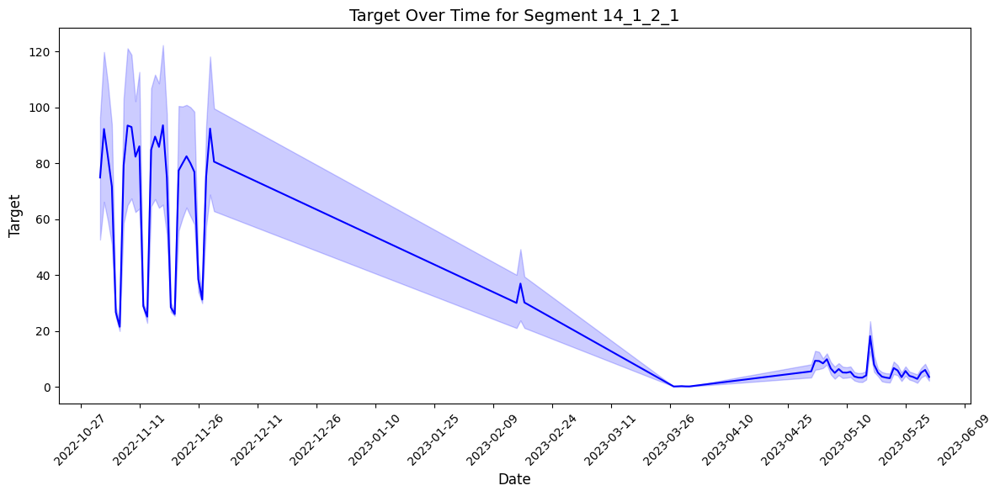

In [11]:
import matplotlib.dates as mdates

# Filter the dataset for the specific segment
for seg in tqdm(df_train_features['segment'].unique()):
    consumption = df_train_features[df_train_features.segment == seg]

    plt.figure(figsize=(12, 6))
    sns.lineplot(x='date', y='target', data=consumption, color='blue', linewidth=1.5)

    plt.title(f'Target Over Time for Segment {seg}', fontsize=14)
    plt.xlabel('Date', fontsize=12)
    plt.ylabel('Target', fontsize=12)
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))  # Format the date display
    plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=15))  # Adjust the interval for better readability
    plt.xticks(rotation=45)  # Rotate x-axis labels for clarity

    # Show the plot
    plt.tight_layout()
    plt.savefig(f'../plots/target_by_seg_lineplot_pretty/tbslp_{seg}')
# plt.show()

## FFT Analysis of Segments

To uncover potential high-frequency patterns within the dataset that may not be immediately apparent, a Fast Fourier Transform (FFT) analysis is conducted on the first ten unique segments of the dataset. This analysis aims to reveal hidden frequency-based characteristics and periodicities within these segments.

### Methodology

1. **Data Preparation**:
   - The first ten unique segments from `df_train_features` are selected for analysis.
   - A subset of the dataset, `example_df`, is created, containing only the data from these segments.

2. **FFT Computation**:
   - FFT is applied to the 'target' column of each segment. This transformation converts the time-domain data into the frequency domain, enabling the identification of dominant frequencies in the data.

3. **Frequency Analysis**:
   - The frequencies corresponding to each FFT value are calculated.
   - The magnitude of each FFT value is computed to quantify the strength of each frequency component.

4. **Normalization and Filtering**:
   - The magnitudes are normalized by dividing them by the maximum magnitude in each segment, ensuring comparability across segments.
   - Frequencies longer than the 'Semiannual' period are filtered out to focus on more relevant, shorter-term cycles.

5. **Visualization**:
   - A log-scaled plot is created to visualize the frequency spectra of each segment.
   - Each segment's spectrum is offset vertically for clarity, allowing distinct visualization of each segment's frequency characteristics.

### Conclusions
- In the first few segments analyzed, there is a notable presence of weak semiannual and quarterly periodicity.
- Across all segments, patterns with sub-monthly and sub-biweekly frequencies, along with their harmonics, are prominently observed. These distinct patterns could be pivotal in identifying features that are correlated with or causally related to weather conditions or energy prices. Alternatively, they may well be artifacts caused by how the data are reported.
- (번역) 모든 세그먼트에서 그 고조파(harmonics)와 함께 월간 및 격주로 하위 빈도를 갖는 패턴이 두드러지게 관찰됩니다. 이러한 독특한 패턴은 기상 조건 또는 에너지 가격과 상관 관계가 있거나 인과 관계가 있는 특징을 식별하는 데 중추적인 역할을 할 수 있습니다. 또는 데이터가 보고되는 방식에 따라 발생하는 인공물일 수도 있습니다.

In [8]:
segment_list = df_train_features.segment.unique() # 10개의 segment를 선택
example_df = df_train_features[np.isin(df_train_features.segment,segment_list)] # 10개의 segment에 해당하는 데이터만 추출

# 'segment' column categorizes different entities 
segments = example_df['segment'].unique() # 10개의 segment를 segments 변수명으로 저장

# Define periods in days and calculate corresponding frequencies
periods = {
    'Annual': 365, # 연간
    'Semiannual': 365 / 2, # 반기별
    'Quarterly': 365 / 4, # 분기별
    'Monthly': 30, # 월별
    'Biweekly': 14, # 격주별
    'Weekly': 7, # 주별
    'Semiweekly': 3.5 # 반주별
}
frequencies_for_periods = {k: 1/v for k, v in periods.items()} # 각 periods별로 주파수를 설정해줌.

# Initialize the figure for the spectra
plt.figure(figsize=(14, 10))

# Convert the x-axis to a log scale
plt.xscale('log')

# Plot the spectrum for each segment with offset
for i, segment in enumerate(example_df['segment'].unique()):
    segment_data = example_df[example_df['segment'] == segment]['target'] # 특정 segment에 해당하는 subset을 선택한 후 target컬럼만 추출
    fft_values = np.fft.fft(segment_data) # fft 수행
    frequencies = np.fft.fftfreq(len(fft_values), d=1)
    magnitudes = np.abs(fft_values)[frequencies > 0]
    normalized_magnitudes = magnitudes / np.max(magnitudes)
    positive_freqs = frequencies[frequencies > 0]

    # Filter out frequencies corresponding to periods longer than 'Semiannual'
    valid_freqs = positive_freqs[positive_freqs > frequencies_for_periods['Semiannual']]
    valid_magnitudes = normalized_magnitudes[positive_freqs > frequencies_for_periods['Semiannual']]

    # Offset each segment's spectrum for clarity
    offset_magnitudes = valid_magnitudes + i

    plt.plot(valid_freqs, offset_magnitudes, label=f'Segment {segment}')

    # Customize the plot
    plt.title('Frequency Spectra of hourly target for Each Segment')
    plt.xlabel('Frequency')
    plt.ylabel('Normalized Magnitude + Offset')

    # Set the x-axis ticks and labels to the calculated frequencies for the periods
    plt.xticks(list(frequencies_for_periods.values()), list(frequencies_for_periods.keys()),rotation=45)

    plt.legend()
    plt.savefig(f'../plots/hourly_target_fft_by_seg_basic/freq_spectra_hourly_target_{segment}.png')
    plt.clf()
# plt.show()

<Figure size 1400x1000 with 0 Axes>

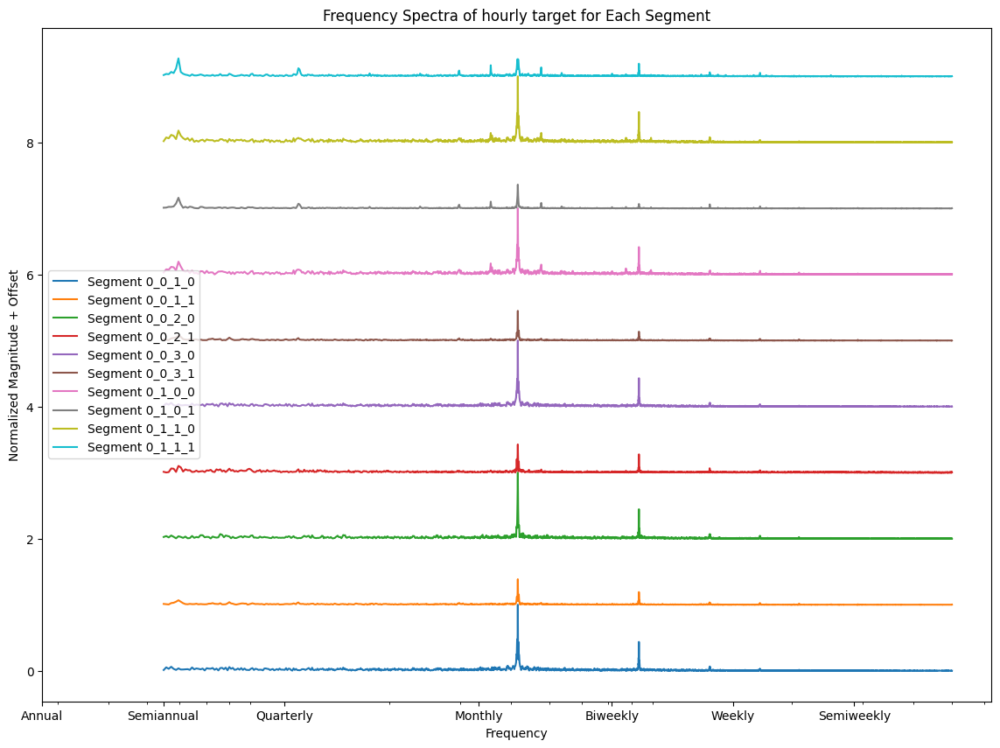

In [23]:
segment_list = df_train_features.segment.unique()[:10] # 10개의 segment를 선택
example_df = df_train_features[np.isin(df_train_features.segment,segment_list)] # 10개의 segment에 해당하는 데이터만 추출

# 'segment' column categorizes different entities 
segments = example_df['segment'].unique() # 10개의 segment를 segments 변수명으로 저장

# Define periods in days and calculate corresponding frequencies
periods = {
    'Annual': 365, # 연간
    'Semiannual': 365 / 2, # 반기별
    'Quarterly': 365 / 4, # 분기별
    'Monthly': 30, # 월별
    'Biweekly': 14, # 격주별
    'Weekly': 7, # 주별
    'Semiweekly': 3.5 # 반주별
}
frequencies_for_periods = {k: 1/v for k, v in periods.items()} # 각 periods별로 주파수를 설정해줌.

# Initialize the figure for the spectra
plt.figure(figsize=(14, 10))

# Convert the x-axis to a log scale
plt.xscale('log')

# Plot the spectrum for each segment with offset
for i, segment in enumerate(example_df['segment'].unique()):
    segment_data = example_df[example_df['segment'] == segment]['target'] # 특정 segment에 해당하는 subset을 선택한 후 target컬럼만 추출
    fft_values = np.fft.fft(segment_data) # fft 수행
    frequencies = np.fft.fftfreq(len(fft_values), d=1)
    magnitudes = np.abs(fft_values)[frequencies > 0]
    normalized_magnitudes = magnitudes / np.max(magnitudes)
    positive_freqs = frequencies[frequencies > 0]

    # Filter out frequencies corresponding to periods longer than 'Semiannual'
    valid_freqs = positive_freqs[positive_freqs > frequencies_for_periods['Semiannual']]
    valid_magnitudes = normalized_magnitudes[positive_freqs > frequencies_for_periods['Semiannual']]

    # Offset each segment's spectrum for clarity
    offset_magnitudes = valid_magnitudes + i

    plt.plot(valid_freqs, offset_magnitudes, label=f'Segment {segment}')

# Customize the plot
plt.title('Frequency Spectra of hourly target for Each Segment')
plt.xlabel('Frequency')
plt.ylabel('Normalized Magnitude + Offset')

# Set the x-axis ticks and labels to the calculated frequencies for the periods
plt.xticks(list(frequencies_for_periods.values()), list(frequencies_for_periods.keys()))

plt.legend()
plt.savefig('../plots/hourly_target_fft_by_seg_basic/freq_spectra.png',dpi=300)
plt.show()

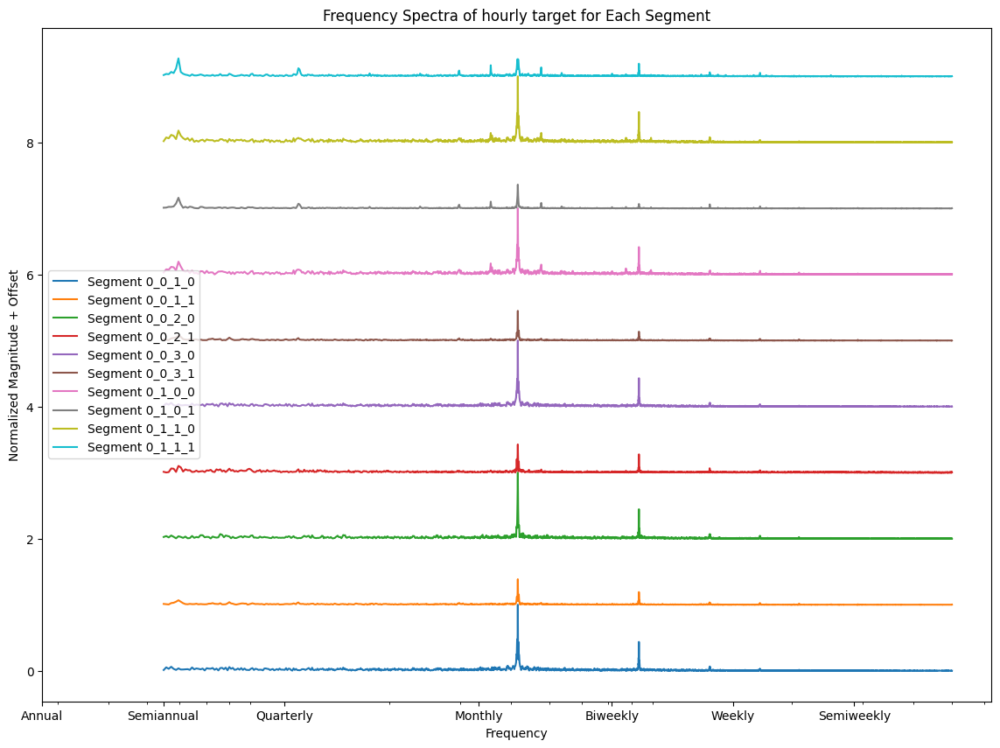### FFT on Temperature
Taking the first segment of the dataframe as an example, performing an FFT on temperature data reveals the following spectrum. The observed sub-monthly periodicity and its harmonics align closely with those of the target, suggesting a significant correlation between energy consumption and local temperature.

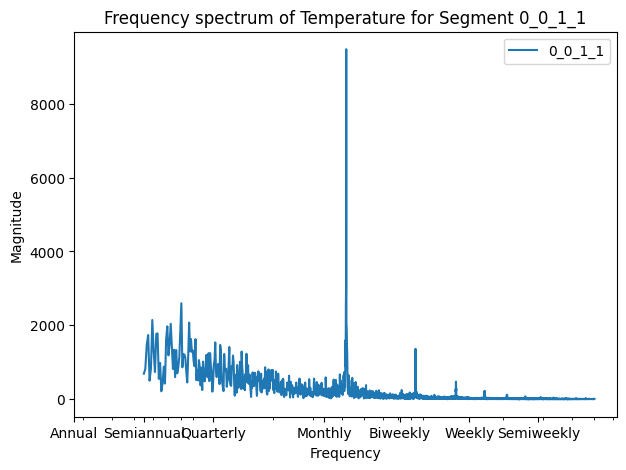

In [8]:
# Initialize the figure for the spectra
plt.figure(figsize=(7, 5))

# Convert the x-axis to a log scale
plt.xscale('log')

# Plot the spectrum for each segment with offset
segment_data = example_df[example_df['segment'] == '0_0_1_1']['temperature']
fft_values = np.fft.fft(segment_data)
frequencies = np.fft.fftfreq(len(fft_values), d=1)
magnitudes = np.abs(fft_values)[frequencies > 0]
positive_freqs = frequencies[frequencies > 0]

# Filter out frequencies corresponding to periods longer than 'Semiannual'
valid_freqs = positive_freqs[positive_freqs > frequencies_for_periods['Semiannual']]
valid_magnitudes = magnitudes[positive_freqs > frequencies_for_periods['Semiannual']]

plt.plot(valid_freqs, valid_magnitudes, label='0_0_1_1')

# Customize the plot
plt.title('Frequency spectrum of Temperature for Segment 0_0_1_1')
plt.xlabel('Frequency')
plt.ylabel('Magnitude')

# Set the x-axis ticks and labels to the calculated frequencies for the periods
plt.xticks(list(frequencies_for_periods.values()), list(frequencies_for_periods.keys()))

plt.legend()
plt.show()

### FFT on Direct Solar Radiation
Temperature should have a strong correlation with direct solar radiatoin, it is not surprising that their fft spectra have the similar but weaker peaks.     
온도는 직접 태양 복사선과 강한 상관관계가 있어야 합니다. 그들의 FFT 스펙트럼이 비슷하지만 약한 피크를 갖는 것은 놀라운 일이 아닙니다.

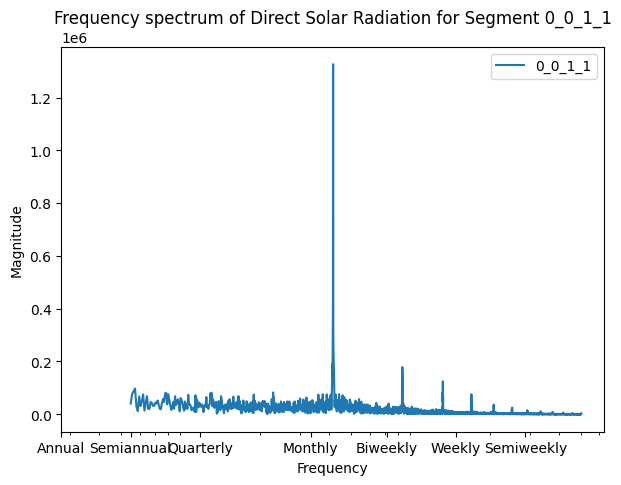

In [9]:
# Initialize the figure for the spectra
plt.figure(figsize=(7, 5))

# Convert the x-axis to a log scale
plt.xscale('log')

# Plot the spectrum for each segment with offset
segment_data = example_df[example_df['segment'] == '0_0_1_1']['direct_solar_radiation']
fft_values = np.fft.fft(segment_data)
frequencies = np.fft.fftfreq(len(fft_values), d=1)
magnitudes = np.abs(fft_values)[frequencies > 0]
positive_freqs = frequencies[frequencies > 0]

# Filter out frequencies corresponding to periods longer than 'Semiannual'
valid_freqs = positive_freqs[positive_freqs > frequencies_for_periods['Semiannual']]
valid_magnitudes = magnitudes[positive_freqs > frequencies_for_periods['Semiannual']]

plt.plot(valid_freqs, valid_magnitudes, label='0_0_1_1')

# Customize the plot
plt.title('Frequency spectrum of Direct Solar Radiation for Segment 0_0_1_1')
plt.xlabel('Frequency')
plt.ylabel('Magnitude')

# Set the x-axis ticks and labels to the calculated frequencies for the periods
plt.xticks(list(frequencies_for_periods.values()), list(frequencies_for_periods.keys()))

plt.legend()
plt.show()

### FFT on 'hours_ahead' Feature
Given that temperature and direct solar radiation are weather-related data from external sources, examining seemingly irrelevant features like 'hours_ahead' could be crucial in verifying the validity of the previously observed peaks. Interestingly, this particular feature displays a stronger frequency signature than both temperature and direct solar radiation. This leads to a possible conclusion: the weather data may not exhibit true periodicity, and the peaks observed in the FFT spectra could be mere artifacts arising from the particular format of the weather data.    
온도와 직접 태양 복사가 외부 소스의 날씨 관련 데이터라는 점을 감안할 때, 'hours_ahead'와 같이 겉보기에는 관련이 없어 보이는 특징을 조사하는 것이 이전에 관찰된 피크의 유효성을 확인하는 데 중요할 수 있습니다. 흥미롭게도 이 특정 특징은 온도와 직접 태양 복사보다 더 강한 주파수 서명을 보여줍니다. 이는 기상 데이터가 실제 주기성을 나타내지 않을 수 있고 FFT 스펙트럼에서 관찰된 피크는 기상 데이터의 특정 형식에서 발생하는 단순한 인공물일 수 있다는 가능한 결론으로 이어집니다.

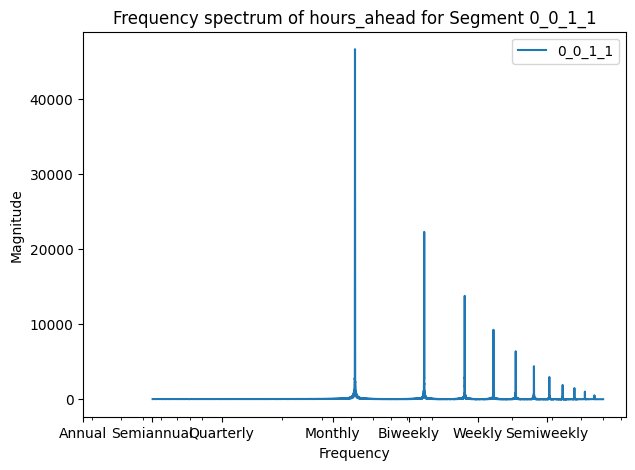

In [10]:
# Initialize the figure for the spectra
plt.figure(figsize=(7, 5))

# Convert the x-axis to a log scale
plt.xscale('log')

# Plot the spectrum for each segment with offset
segment_data = example_df[example_df['segment'] == '0_0_1_1']['hours_ahead']
fft_values = np.fft.fft(segment_data)
frequencies = np.fft.fftfreq(len(fft_values), d=1)
magnitudes = np.abs(fft_values)[frequencies > 0]
positive_freqs = frequencies[frequencies > 0]

# Filter out frequencies corresponding to periods longer than 'Semiannual'
valid_freqs = positive_freqs[positive_freqs > frequencies_for_periods['Semiannual']]
valid_magnitudes = magnitudes[positive_freqs > frequencies_for_periods['Semiannual']]

plt.plot(valid_freqs, valid_magnitudes, label='0_0_1_1')

# Customize the plot
plt.title('Frequency spectrum of hours_ahead for Segment 0_0_1_1')
plt.xlabel('Frequency')
plt.ylabel('Magnitude')

# Set the x-axis ticks and labels to the calculated frequencies for the periods
plt.xticks(list(frequencies_for_periods.values()), list(frequencies_for_periods.keys()))

plt.legend()
plt.show()

### FFT on Gas Price: Counter Examples
To prove that the peaks observed above come exclusively from the weather dataset, we have two pieces of evidence. The first piece is that in the gas price data, there is no discernable peaks.

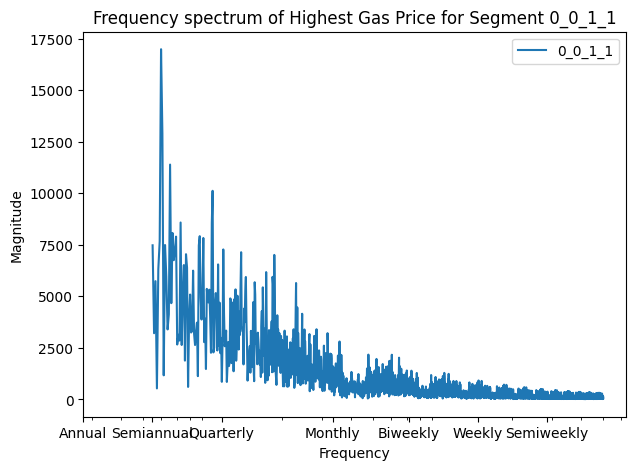

In [11]:
# Initialize the figure for the spectra
plt.figure(figsize=(7, 5))

# Convert the x-axis to a log scale
plt.xscale('log')

# Plot the spectrum for each segment with offset
segment_data = example_df[example_df['segment'] == '0_0_1_1']['highest_price_per_mwh']
fft_values = np.fft.fft(segment_data)
frequencies = np.fft.fftfreq(len(fft_values), d=1)
magnitudes = np.abs(fft_values)[frequencies > 0]
positive_freqs = frequencies[frequencies > 0]

# Filter out frequencies corresponding to periods longer than 'Semiannual'
valid_freqs = positive_freqs[positive_freqs > frequencies_for_periods['Semiannual']]
valid_magnitudes = magnitudes[positive_freqs > frequencies_for_periods['Semiannual']]

# Offset each segment's spectrum for clarity
offset_magnitudes = valid_magnitudes + i

plt.plot(valid_freqs, offset_magnitudes, label='0_0_1_1')

# Customize the plot
plt.title('Frequency spectrum of Highest Gas Price for Segment 0_0_1_1')
plt.xlabel('Frequency')
plt.ylabel('Magnitude')

# Set the x-axis ticks and labels to the calculated frequencies for the periods
plt.xticks(list(frequencies_for_periods.values()), list(frequencies_for_periods.keys()))

plt.legend()
plt.show()

### FFT on Averaged Daily Target: Counter Examples
Another piece of evidence emerges when we aggregate the hourly target values into daily ones and then perform an FFT analysis on them. If the periodicity is real, the sub-weekly patterns should remain prominent, even with the loss of high-frequency hourly patterns. However, contrary to this expectation, the sharp peaks observed earlier vanish, leaving only weekly and semiweekly patterns that align with our real-world experiences.

### Conclusions for FFT Analysis
- The peaks observed in the FFT analysis of the original dataset are likely artifacts from the hourly local weather data.
- Some segments display a distinct weekday/weekend energy consumption pattern, while others do not.
- 원래 데이터 세트의 FFT 분석에서 관찰된 피크는 시간별 지역 날씨 데이터의 인공물일 가능성이 높습니다.
- 어떤 세그먼트는 평일/주말 에너지 소비 패턴이 뚜렷하지만, 어떤 세그먼트는 그렇지 않습니다.

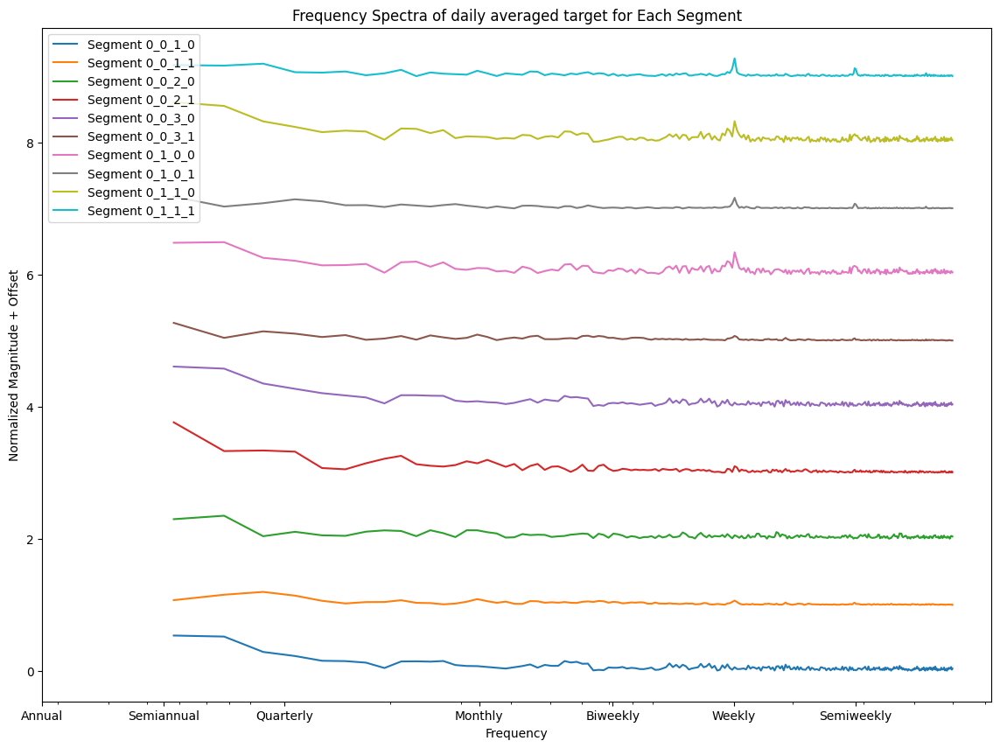

In [12]:
segment_list = df_train_features.segment.unique()[:10]
example_df = df_train_features[np.isin(df_train_features.segment,segment_list)]

# Initialize the figure for the spectra
plt.figure(figsize=(14, 10))

# Convert the x-axis to a log scale
plt.xscale('log')

# Plot the spectrum for each segment with offset
for i, segment in enumerate(example_df['segment'].unique()):
    segment_data = example_df[example_df['segment'] == segment].groupby('date')['target'].mean()
    fft_values = np.fft.fft(segment_data)
    frequencies = np.fft.fftfreq(len(fft_values), d=1)
    magnitudes = np.abs(fft_values)[frequencies > 0]
    normalized_magnitudes = magnitudes / np.max(magnitudes)
    positive_freqs = frequencies[frequencies > 0]

    # Filter out frequencies corresponding to periods longer than 'Semiannual'
    valid_freqs = positive_freqs[positive_freqs > frequencies_for_periods['Semiannual']]
    valid_magnitudes = normalized_magnitudes[positive_freqs > frequencies_for_periods['Semiannual']]

    # Offset each segment's spectrum for clarity
    offset_magnitudes = valid_magnitudes + i

    plt.plot(valid_freqs, offset_magnitudes, label=f'Segment {segment}')

# Customize the plot
plt.title('Frequency Spectra of daily averaged target for Each Segment')
plt.xlabel('Frequency')
plt.ylabel('Normalized Magnitude + Offset')

# Set the x-axis ticks and labels to the calculated frequencies for the periods
plt.xticks(list(frequencies_for_periods.values()), list(frequencies_for_periods.keys()))

plt.legend()
plt.show()

## Singular-Spectrum Analysis (SSA)
Another tool for time-series data analysis is Singular Spectrum Analysis (SSA), which can be considered similar to Principal Component Analysis (PCA) but specifically tailored for time-series data.

This method involves constructing a trajectory matrix using lagged versions of the time series as its columns. By performing singular value decomposition (SVD) on this trajectory matrix, we can extract the principal components of the time series, which encapsulate key temporal characteristics such as trends and periodicities.

Unlike the Fourier transform (fft), SSA does not restrict components to be periodic; it can also capture irregular components, such as trends, which fft may not effectively represent. For more detailed explanation into this method, refer to this excellent [notebook](https://www.kaggle.com/code/jdarcy/introducing-ssa-for-time-series-decomposition/notebook#4.-A-Python-Class-for-SSA).

In [13]:
from numpy.linalg import svd, matrix_rank

class SSA:
    def __init__(self, series, window_size):
        self.series = np.array(series)
        self.window_size = window_size
        self.n = len(series)
        self.trajectory_matrix = self.create_trajectory_matrix()

    def create_trajectory_matrix(self):
        n_vectors = self.n - self.window_size + 1
        return np.column_stack([self.series[i:i+self.window_size] for i in range(n_vectors)])

    def decompose(self):
        U, sigma, Vt = svd(self.trajectory_matrix)
        self.rank = matrix_rank(self.trajectory_matrix)
        return U, sigma, Vt

    def reconstruct(self, U, sigma, Vt, components):
        rank = len(components)
        if rank > self.rank:
            raise ValueError("Number of components cannot be greater than the rank of the trajectory matrix")

        series_components = []
        for i in components:
            X_i = sigma[i] * np.outer(U[:,i], Vt[i,:])
            series_components.append(self.diagonal_averaging(X_i))
        
        return sum(series_components)

    def diagonal_averaging(self, X_i):
        n_rows, n_cols = X_i.shape
        diagonals = [X_i[::-1, :].diagonal(i) for i in range(-X_i.shape[0]+1, X_i.shape[1])]
        return np.array([np.mean(diagonal) for diagonal in diagonals])
    
    def calculate_w_correlation(self):
        n = self.window_size
        N = self.n
        K = N - n + 1
        w = np.array([min(i+1, n, N-i) for i in range(N)])
        w_corr_matrix = np.zeros((self.rank, self.rank))

        for i in range(self.rank):
            for j in range(self.rank):
                if i <= j:
                    F_i = self.reconstruct(U, sigma, Vt, [i])
                    F_j = self.reconstruct(U, sigma, Vt, [j])
                    w_corr_matrix[i, j] = np.sum(w * F_i * F_j) / np.sqrt(np.sum(w * F_i ** 2) * np.sum(w * F_j ** 2))
                    w_corr_matrix[j, i] = w_corr_matrix[i, j]
        
        return w_corr_matrix

    def plot_w_correlation(self, U, sigma, Vt):
        w_corr_matrix = self.calculate_w_correlation()
        plt.imshow(w_corr_matrix, cmap='hot', interpolation='nearest')
        plt.colorbar()
        plt.title('W-Correlation Matrix')
        plt.xlabel('Component')
        plt.ylabel('Component')
        plt.show()

### SSA Reconstruction
Considering the artifacts introduced by the hourly data, we will use daily aggregated data for our SSA analysis.

When we reconstruct the time series using the first five components, it becomes apparent that these components effectively capture the general trends of the time series. Furthermore, the analysis of the residuals reveals critical insights. Apart from the annual trend captured by the first few components, it is essential to consider high-frequency components that also contribute significantly to the dataset's characteristics, such as those wave-like fluctuations at the beginning of the time series.

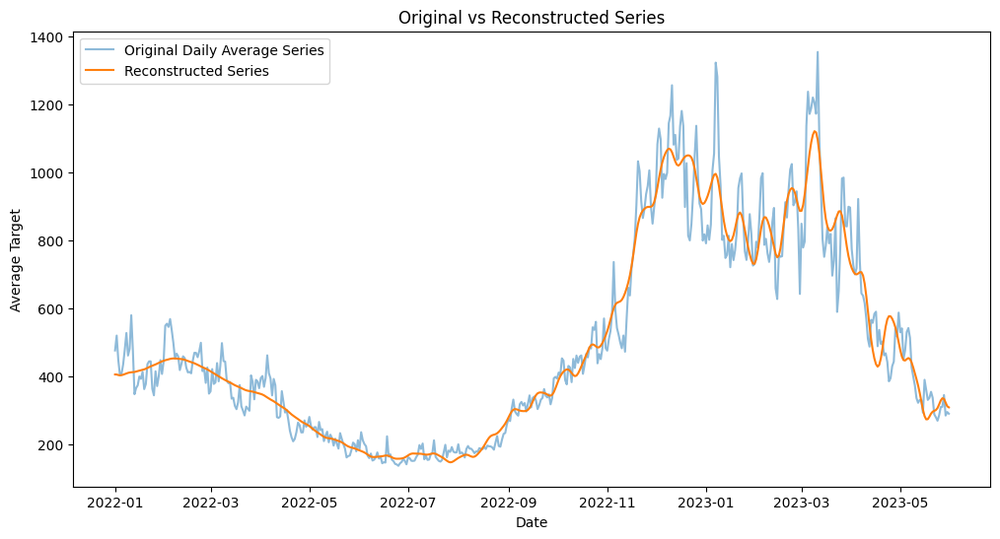

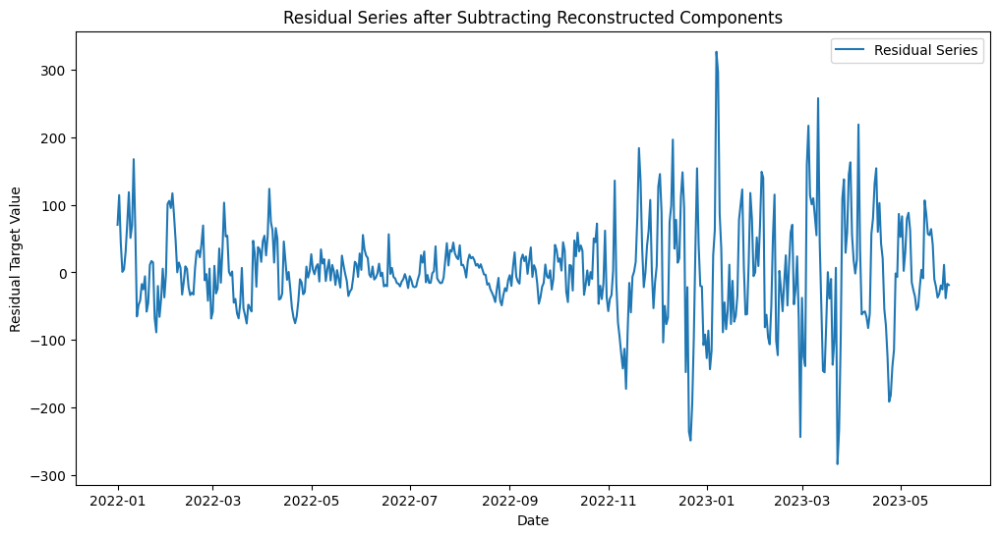

In [19]:
# Group by 'date' and calculate the mean of 'target' for each day
daily_avg = consumption_0_0_1_1.groupby('date')['target'].mean()

# Decompose the time series into 200 components, set by window_size
window_size = 200
ssa = SSA(daily_avg, window_size)
U, sigma, Vt = ssa.decompose()

# Reconstruct the series using the first 10 components
reconstructed_series = ssa.reconstruct(U, sigma, Vt, components=list(range(10)))

# Plot the original and reconstructed series
plt.figure(figsize=(12, 6))
plt.plot(daily_avg.index, daily_avg.values, alpha=0.5, label='Original Daily Average Series')
plt.plot(daily_avg.index, reconstructed_series, label='Reconstructed Series')
plt.title('Original vs Reconstructed Series')
plt.xlabel('Date')
plt.ylabel('Average Target')
plt.legend()
plt.show()

# Subtract the reconstructed series from the original series
residual_series = daily_avg - reconstructed_series

# Plot the residual series
plt.figure(figsize=(12, 6))
plt.plot(daily_avg.index, residual_series, label='Residual Series')
plt.title('Residual Series after Subtracting Reconstructed Components')
plt.xlabel('Date')
plt.ylabel('Residual Target Value')
plt.legend()
plt.show()


### SSA Components
The first ten mode shapes are presented below. The initial few components predominantly represent trends, while the higher components increasingly exhibit oscillatory behaviors, characterized by progressively higher frequencies. Notice that some modes are quite similar and that is totally normal in SSA. The resemblance between different modes can be visualized in the w-correlation matrix.

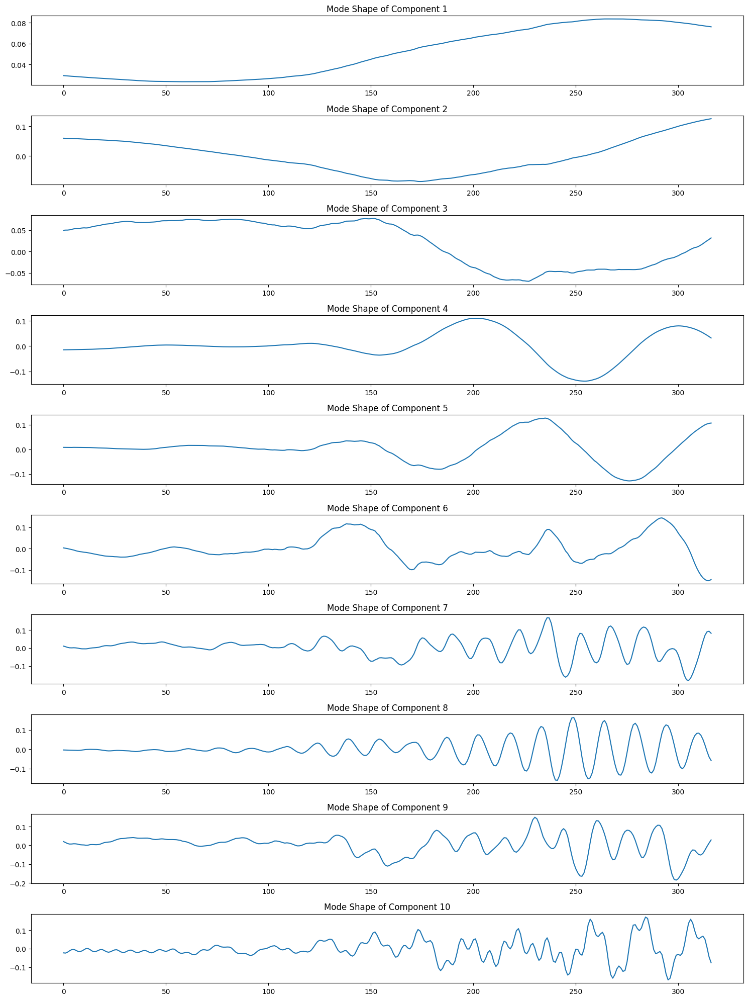

In [20]:
plt.figure(figsize=(15, 20))
for i in range(10):
    plt.subplot(10, 1, i+1)
    plt.plot(Vt[i, :], label=f'Component {i+1}')
    plt.title(f'Mode Shape of Component {i+1}')
plt.tight_layout()
plt.show()

### W-correlation Matrix
The w-correlation matrix effectively visualizes the similarity between different modes, often resulting in adjacent modes displaying similar structures and high correlations, as evidenced by the blocky appearance in the matrix. While it is theoretically possible to set a threshold for the components to distinguish the true trend from noise, thereby utilizing this information for predictive modeling, the current data volume appears too substantial to process effectively at this stage. Therefore, for the predictive modeling aspect, we will employ a voting regression approach with LightGBM models, using lag features to compensate for the inability of LightGBM in dealing with time-series data.

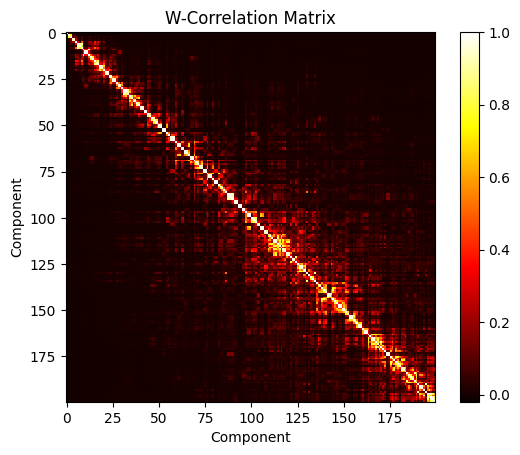

In [21]:
ssa.plot_w_correlation(U, sigma, Vt)

# Predictive Modelling
Here we define a series of dictionaries in `parameter_list`, each representing a set of hyperparameters for a LightGBM model. LightGBM is a gradient boosting framework used for machine learning tasks. Each dictionary includes various hyperparameters that control how the LightGBM model is trained. Here we first drop the date column that is redundant for the model. Second we do a randomized search on parameter space to find the best set of parameters for LightGBM model.

In [22]:
df_train_features = df_train_features.drop('date', axis=1)

### Randomized Search
The following code is used to find ten optimal set of parameters for LGBM with different random seed. It takes two hours to run in my machine so they are all commented out in this notebook.

In [ ]:
# import lightgbm as lgb
# import random
# from sklearn.model_selection import RandomizedSearchCV
# from scipy.stats import randint as sp_randint
# from scipy.stats import uniform as sp_uniform

# def tune_lgbm_model(X_train, y_train, random_state, n_iter=50, cv=3):
#     param_dist = {
#         'path_smooth': sp_uniform(0.01, 0.09),
#         'colsample_bytree': sp_uniform(0.1, 0.9),
#         'colsample_bynode': sp_uniform(0.1, 0.9),
#         'reg_alpha': sp_uniform(1, 9), 
#         'reg_lambda': sp_uniform(1, 9), 
#         'num_leaves': sp_randint(31, 500),
#         'min_child_samples': sp_randint(30, 250),
#         'max_depth': sp_randint(1, 29),
#         'learning_rate': sp_uniform(0.001, 0.09),
#         'objective': ['regression', 'regression_l1', 'huber', 'fair', 'poisson', 'quantile', 'mape', 'gamma', 'tweedie']
#     }

#     lgb_reg = lgb.LGBMRegressor()

#     random_search = RandomizedSearchCV(
#         estimator=lgb_reg, 
#         param_distributions=param_dist,
#         n_iter=n_iter, 
#         scoring='neg_mean_absolute_error',
#         cv=cv, 
#         verbose=0, 
#         random_state=random_state
#     )

#     random_search.fit(X_train, y_train)

#     return random_search.best_params_

# random_states = random.sample(range(1, 100), 10)

# mask = df_train_features['is_consumption'] == 1
# X_train = df_train_features[mask].drop(columns=["target"])
# y_train = df_train_features[mask]["target"]

# parameter_list = []

# for rs in random_states:
#     best_params = tune_lgbm_model(X_train, y_train, rs)
#     best_params_with_fixed = {
#         'num_iterations': 500,
#         'verbose': -1,
#         **best_params
#     }
#     parameter_list.append(best_params_with_fixed)
#     print(f"Best parameters for random state {rs}: {best_params_with_fixed}")

Here are the optimized parameters copied from my local calculation.

In [23]:
parameter_list = [{'num_iterations': 500, 'verbose': -1, 'colsample_bynode': 0.7103688779357847, 'colsample_bytree': 0.6759995481832958, 'learning_rate': 0.08107710302284142, 'max_depth': 14, 'min_child_samples': 175, 'num_leaves': 169, 'objective': 'tweedie', 'path_smooth': 0.03638766162304646, 'reg_alpha': 4.241310552615537, 'reg_lambda': 1.91388003514709}, {'num_iterations': 500, 'verbose': -1, 'colsample_bynode': 0.5762487113184288, 'colsample_bytree': 0.5811355426944578, 'learning_rate': 0.08597630012152205, 'max_depth': 26, 'min_child_samples': 194, 'num_leaves': 361, 'objective': 'regression', 'path_smooth': 0.03465551777589707, 'reg_alpha': 6.996661462358405, 'reg_lambda': 8.470525016492395}, {'num_iterations': 500, 'verbose': -1, 'colsample_bynode': 0.43517350965256685, 'colsample_bytree': 0.7831532979997649, 'learning_rate': 0.07025903099500738, 'max_depth': 23, 'min_child_samples': 211, 'num_leaves': 321, 'objective': 'regression', 'path_smooth': 0.08559566561454247, 'reg_alpha': 2.6435598455478146, 'reg_lambda': 4.51993047978816}, {'num_iterations': 500, 'verbose': -1, 'colsample_bynode': 0.6069746474662208, 'colsample_bytree': 0.47723286276461496, 'learning_rate': 0.06380390287538754, 'max_depth': 10, 'min_child_samples': 245, 'num_leaves': 192, 'objective': 'regression', 'path_smooth': 0.03607590859625657, 'reg_alpha': 3.3788113950113328, 'reg_lambda': 5.702284030317997}, {'num_iterations': 500, 'verbose': -1, 'colsample_bynode': 0.360239888533631, 'colsample_bytree': 0.8355751080647349, 'learning_rate': 0.07606039804311976, 'max_depth': 16, 'min_child_samples': 121, 'num_leaves': 478, 'objective': 'regression', 'path_smooth': 0.0997680881977257, 'reg_alpha': 3.734520254197353, 'reg_lambda': 9.635057034367291}, {'num_iterations': 500, 'verbose': -1, 'colsample_bynode': 0.4174740961644613, 'colsample_bytree': 0.7508888306232886, 'learning_rate': 0.07708410483102476, 'max_depth': 25, 'min_child_samples': 216, 'num_leaves': 380, 'objective': 'regression', 'path_smooth': 0.06390932048435091, 'reg_alpha': 3.326634605594462, 'reg_lambda': 4.437207873684814}, {'num_iterations': 500, 'verbose': -1, 'colsample_bynode': 0.7381382697935609, 'colsample_bytree': 0.523576726896179, 'learning_rate': 0.06981333132164486, 'max_depth': 11, 'min_child_samples': 126, 'num_leaves': 214, 'objective': 'tweedie', 'path_smooth': 0.07218072257652315, 'reg_alpha': 9.975905654063325, 'reg_lambda': 2.551064575107957}, {'num_iterations': 500, 'verbose': -1, 'colsample_bynode': 0.9235361356621526, 'colsample_bytree': 0.43075258164239827, 'learning_rate': 0.06755536733597006, 'max_depth': 28, 'min_child_samples': 243, 'num_leaves': 213, 'objective': 'regression', 'path_smooth': 0.020429341100388392, 'reg_alpha': 2.553972315959381, 'reg_lambda': 2.4041022554705522}, {'num_iterations': 500, 'verbose': -1, 'colsample_bynode': 0.44166912467574293, 'colsample_bytree': 0.6606565063118934, 'learning_rate': 0.0897868781748779, 'max_depth': 18, 'min_child_samples': 240, 'num_leaves': 42, 'objective': 'tweedie', 'path_smooth': 0.01116875211972208, 'reg_alpha': 2.4423874109911345, 'reg_lambda': 4.128799810939097}, {'num_iterations': 500, 'verbose': -1, 'colsample_bynode': 0.9525732017313245, 'colsample_bytree': 0.6382630603007415, 'learning_rate': 0.08270391387009293, 'max_depth': 12, 'min_child_samples': 243, 'num_leaves': 292, 'objective': 'tweedie', 'path_smooth': 0.08723701882589538, 'reg_alpha': 6.1157717164194905, 'reg_lambda': 6.675900725606523}]

## Model Creation
Here we train two `VotingRegressor` models using the LightGBM framework for different target variables. The use of `VotingRegressor` with multiple LightGBM models allows leveraging the strengths of different hyperparameter configurations.
- Comprises an ensemble of 10 LightGBM regressor models (`lgb_0` to `lgb_9`, and `lgb_10` to `lgb_19`).
- Each regressor is initialized with distinct sets of hyperparameters (`p1` to `p9`).
- The models are combined using weights `[0.14, 0.13, 0.08, 0.11, 0.09, 0.1, 0.09, 0.07, 0.12, 0.07]`.
   
## Model Training
- The model is trained on a subset of `df_train_features` where 'is_consumption' is 1 (true).
- The target variable (`y`) for training is taken from the 'target' column of the same subset.


In [ ]:
model_consumption = VotingRegressor([
        ('lgb_0', lgb.LGBMRegressor(**parameter_list[0], random_state=42)),
        ('lgb_1', lgb.LGBMRegressor(**parameter_list[1], random_state=42)),
        ('lgb_2', lgb.LGBMRegressor(**parameter_list[2], random_state=42)), 
        ('lgb_3', lgb.LGBMRegressor(**parameter_list[3], random_state=42)), 
        ('lgb_4', lgb.LGBMRegressor(**parameter_list[4], random_state=42)), 
        ('lgb_5', lgb.LGBMRegressor(**parameter_list[5], random_state=42)), 
        ('lgb_6', lgb.LGBMRegressor(**parameter_list[6], random_state=42)), 
        ('lgb_7', lgb.LGBMRegressor(**parameter_list[7], random_state=42)),
        ('lgb_8', lgb.LGBMRegressor(**parameter_list[8], random_state=42)),
        ('lgb_9', lgb.LGBMRegressor(**parameter_list[9], random_state=42)),
],weights=[0.14,0.13,0.08,0.11,0.09,0.1,0.09,0.07,0.12,0.07])
    
model_production = VotingRegressor([
        ('lgb_10', lgb.LGBMRegressor(**parameter_list[0], random_state=42)),
        ('lgb_11', lgb.LGBMRegressor(**parameter_list[1], random_state=42)),
        ('lgb_12', lgb.LGBMRegressor(**parameter_list[2], random_state=42)), 
        ('lgb_13', lgb.LGBMRegressor(**parameter_list[3], random_state=42)), 
        ('lgb_14', lgb.LGBMRegressor(**parameter_list[4], random_state=42)), 
        ('lgb_15', lgb.LGBMRegressor(**parameter_list[5], random_state=42)), 
        ('lgb_16', lgb.LGBMRegressor(**parameter_list[6], random_state=42)), 
        ('lgb_17', lgb.LGBMRegressor(**parameter_list[7], random_state=42)),
        ('lgb_18', lgb.LGBMRegressor(**parameter_list[8], random_state=42)),
        ('lgb_19', lgb.LGBMRegressor(**parameter_list[9], random_state=42)),
],weights=[0.14,0.13,0.08,0.11,0.09,0.1,0.09,0.07,0.12,0.07])

mask = df_train_features['is_consumption'] == 1
model_consumption.fit(
    X=df_train_features[mask].drop(columns=["target"]),
    y=df_train_features[mask]["target"]
)

mask = df_train_features['is_consumption'] == 0
model_production.fit(
    X=df_train_features[mask].drop(columns=["target"]),
    y=df_train_features[mask]["target"]
)

# Submit API

In [ ]:
import enefit
env = enefit.make_env()
iter_test = env.iter_test()

In [ ]:
for (
    test, 
    revealed_targets, 
    client, 
    historical_weather,
    forecast_weather, 
    electricity_prices, 
    gas_prices, 
    sample_prediction
) in iter_test:
    
    test = test.rename(columns={"prediction_datetime": "datetime"})
    
    df_test = pl.from_pandas(test[data_cols[1:]], schema_overrides=schema_data)
    df_client = pl.from_pandas(client[client_cols], schema_overrides=schema_client)
    df_gas_prices = pl.from_pandas(gas_prices[gas_prices_cols], schema_overrides=schema_gas)
    df_electricity_prices = pl.from_pandas(electricity_prices[electricity_prices_cols], schema_overrides=schema_electricity)
    df_new_forecast_weather = pl.from_pandas(forecast_weather[forecast_weather_cols], schema_overrides=schema_forecast)
    df_new_historical_weather = pl.from_pandas(historical_weather[historical_weather_cols], schema_overrides=schema_historical)
    df_new_target = pl.from_pandas(revealed_targets[target_cols], schema_overrides=schema_target)
    
    df_forecast_weather = pl.concat([df_forecast_weather, df_new_forecast_weather]).unique(['forecast_datetime', 'latitude', 'longitude', 'hours_ahead'])
    df_historical_weather = pl.concat([df_historical_weather, df_new_historical_weather]).unique(['datetime', 'latitude', 'longitude'])
    df_target = pl.concat([df_target, df_new_target]).unique(['datetime', 'county', 'is_business', 'product_type', 'is_consumption'])
    
    df_test_features = generate_features(
        df_test, 
        df_client, 
        df_gas_prices, 
        df_electricity_prices, 
        df_forecast_weather, 
        df_historical_weather, 
        df_weather_station_to_county_mapping, 
        df_target
    )
    df_test_features = to_pandas(df_test_features)
    df_test_features = df_test_features.drop('date',axis=1)
    
    mask = df_test_features['is_consumption'] == 1
    # clip method makes values < 0 equal 0 because our target is nonnegative and models can produce negative values
    sample_prediction.loc[mask.values, "target"] = model_consumption.predict(df_test_features[mask]).clip(0)
    
    mask = df_test_features['is_consumption'] == 0
    sample_prediction.loc[mask.values, "target"] = model_production.predict(df_test_features[mask]).clip(0)
    
    # send predictions
    env.predict(sample_prediction)